In [147]:
#HSV segmentation

In [148]:
%matplotlib inline

In [149]:
from matplotlib import pyplot as plt
from skimage import data,color, exposure,feature,io
import math
from PIL import Image
import numpy as np

In [150]:
#loading data

In [151]:


imgSamples = [];
imgHsvSamples = [];

for n in range(0,18):
    imgSamples.append(np.array(Image.open('renamed-samples1/'+str(n+1)+'.bmp')))
                      
for n in range(0,18):
    imgHsvSamples.append(color.rgb2hsv(imgSamples[n]))


print(len(imgSamples))  
print(len(imgHsvSamples))  
print(imgSamples[0].shape);
print(imgHsvSamples[0].shape);

18
18
(1080, 1920, 3)
(1080, 1920, 3)


In [152]:
#plotting

In [153]:
def hsvFilter(hsv_img):
    return ((hsv_img[:,:,0]<0.9) & (hsv_img[:,:,0]>0.01)) & ((hsv_img[:,:,1]<0.7) & (hsv_img[:,:,1]>0.1))

In [154]:
def hsvFilterStrict(hsv_img):
    return ((hsv_img[:,:,0]<0.9) & (hsv_img[:,:,0]>0.1)) & ((hsv_img[:,:,1]<0.7) & (hsv_img[:,:,1]>0.1))

18


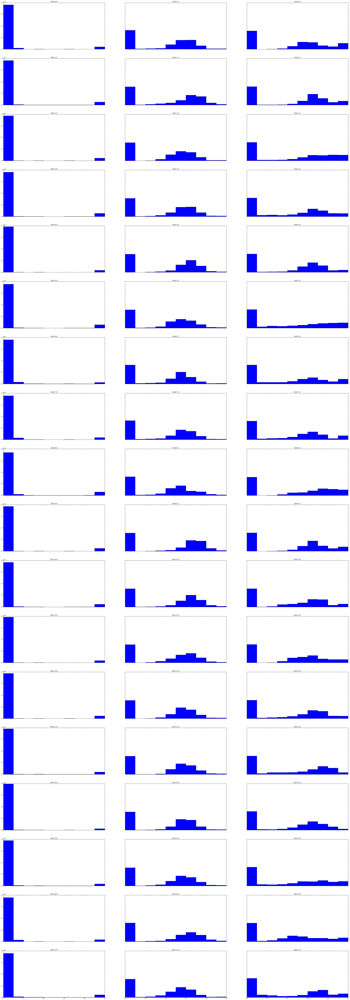

In [155]:
colnum = 3
# rownum = int(math.floor((float(len(imgSamples))/ float(colnum))+1))
rownum = len(imgSamples)
print(rownum)

fig, axes = plt.subplots(rownum, colnum, figsize=(50, rownum*8), sharex=True, sharey=True)
ax = axes.ravel()
index = 0


for i in range(0, len(imgHsvSamples)):
    tmpimg = imgHsvSamples[i]
    for k in range(0,3):
        ax_hist = ax[index+k]
        ax_hist.hist(tmpimg[:,:,k].ravel())
        ax_hist.set_title("histo "+str(i)+"-"+str(k))
        ax[index+k].axis('on')
        ax_hist.ticklabel_format(axis='y', style='scientific', scilimits=(0, 0))
        
    index +=3
    
plt.show()


In [156]:
#############HUE PROPERTIES###################

In [157]:
##the lower the hue the darker the colors

In [158]:
##High frequency colors(flash light noise on image, dark spot, and very bright colors liks red veins) are below <0.1 hue

In [159]:
#############SATURATION/INTENSITY PROPERTIES###################

In [160]:
##the lower the saturation the briter the colors

In [161]:
##Saturation or <0.4 will filter out flash light(low instensity color)

In [177]:
def hsvFilter2(hsv_img):
    return ((hsv_img[:,:,0]<0.9) & (hsv_img[:,:,0]>0.05)) & (((hsv_img[:,:,1]<0.2) & (hsv_img[:,:,1]>0.1)) | ((hsv_img[:,:,1]>0.8)))

def hsvFilter3(hsv_img):
    return  ((hsv_img[:,:,0]<0.1))

def hsvFilter4(hsv_img):
    return  (hsv_img[:,:,1]<0.4)

def hsvFilter5(hsv_img):
    return  (hsv_img[:,:,1]>0.5)&(hsv_img[:,:,1]<0.7)

def hsvFilter6(hsv_img):
    return  (hsv_img[:,:,1]>0.55)&(hsv_img[:,:,1]<0.65)


def hsvFilter7(hsv_img):
    return  ((hsv_img[:,:,1]>0.5)&(hsv_img[:,:,1]<0.7))&((hsv_img[:,:,0]<0.1) & (hsv_img[:,:,0]>0.01))

18


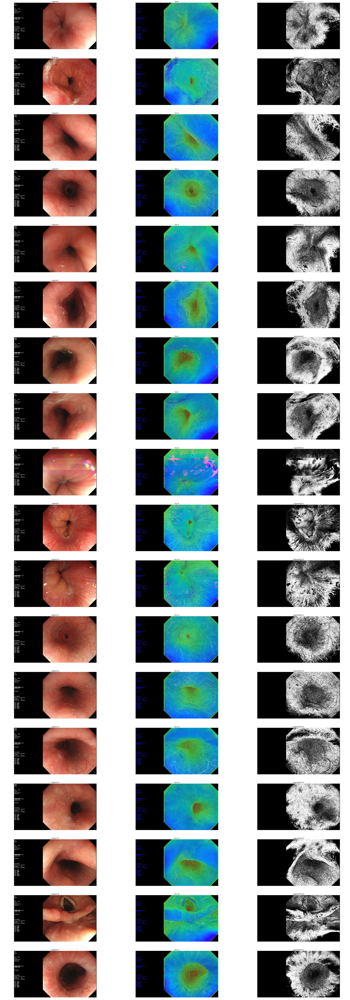

In [178]:
colnum = 3
# rownum = int(math.floor((float(len(imgSamples))/ float(colnum))+1))
rownum = len(imgSamples)
print(rownum)

fig, axes = plt.subplots(rownum, colnum, figsize=(50, rownum*8), sharex=True, sharey=True)
ax = axes.ravel()
index = 0


for i in range(0, len(imgHsvSamples)):
    
    ax[index].imshow(imgSamples[i],cmap='gray')
    ax[index].set_title("original "+str(i))
    ax[index].axis('off') 
    
    ax[index+1].imshow(imgHsvSamples[i],cmap='gray')
    ax[index+1].set_title("hsv "+str(i))
    ax[index+1].axis('off') 
    
    ax[index+2].imshow(hsvFilter7(imgHsvSamples[i]),cmap='gray')
    ax[index+2].set_title("segmented "+str(i))
    ax[index+2].axis('off') 
        
    index +=3
    
plt.show()